#AI Assignment

##Image Classification using transfer learning

###Downloading dataset

Downloading dataset using wget and unzipping it

In [4]:
!pip install wget

  Preparing metadata (setup.py) ... done
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9655 sha256=23469d91a3744d4f880eec5f7d17026f0ac5c9421bf5b529e57fe9afa6bdbe6b
  Stored in directory: /root/.cache/pip/wheels/8b/f1/7f/5c94f0a7a505ca1c81cd1d9208ae2064675d97582078e6c769
Successfully built wget


In [5]:
import wget

In [6]:
file_from = 'https://datasetdumps.s3.ap-south-1.amazonaws.com/Rezang_Dataset.zip'
file_to = '/content/images.zip'
wget.download(file_from,file_to)

'/content/images.zip'

In [7]:
!unzip images.zip -d images

Archive:  images.zip
   creating: images/Dataset/
  inflating: images/__MACOSX/._Dataset  
  inflating: images/Dataset/.DS_Store  
  inflating: images/__MACOSX/Dataset/._.DS_Store  
   creating: images/Dataset/Ayrshire cattle/
  inflating: images/__MACOSX/Dataset/._Ayrshire cattle  
   creating: images/Dataset/Holstein Friesian cattle/
  inflating: images/__MACOSX/Dataset/._Holstein Friesian cattle  
   creating: images/Dataset/Jersey cattle/
  inflating: images/__MACOSX/Dataset/._Jersey cattle  
   creating: images/Dataset/Brown Swiss cattle/
  inflating: images/__MACOSX/Dataset/._Brown Swiss cattle  
   creating: images/Dataset/Red Dane cattle/
  inflating: images/__MACOSX/Dataset/._Red Dane cattle  
  inflating: images/Dataset/Ayrshire cattle/Ayrshirecattle64.jpg  
  inflating: images/__MACOSX/Dataset/Ayrshire cattle/._Ayrshirecattle64.jpg  
  inflating: images/Dataset/Ayrshire cattle/Ayrshirecattle70.jpg  
  inflating: images/__MACOSX/Dataset/Ayrshire cattle/._Ayrshirecattle70.jpg 

###All necessary imports

In [8]:
!pip install -q torchinfo

In [9]:
!pip install torcheval torcheval

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.4/158.4 kB 3.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 111.0/111.0 kB 6.6 MB/s eta 0:00:00


In [10]:
import torch
import torchvision
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
from torch.utils import data
import PIL
import numpy as np
from torch import nn
from torchinfo import summary
import torch.nn.functional as F
import time
from torch.autograd import Variable
from sklearn.metrics import f1_score
from torcheval.metrics.functional import multiclass_f1_score

###Reading dataset using PyTorch's ImageFolder

ImageFolder requires folder structure in subtree like

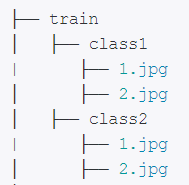

In [11]:
path = '/content/images/Dataset'

dataset = ImageFolder(root=path)

# Print class names and their corresponding indices
class_names = dataset.classes
class_to_idx = dataset.class_to_idx
print("Class Names:", class_names)
print("Class to Index Mapping:", class_to_idx)
print("Total number of images:", len(dataset))

Class Names: ['Ayrshire cattle', 'Brown Swiss cattle', 'Holstein Friesian cattle', 'Jersey cattle', 'Red Dane cattle']
Class to Index Mapping: {'Ayrshire cattle': 0, 'Brown Swiss cattle': 1, 'Holstein Friesian cattle': 2, 'Jersey cattle': 3, 'Red Dane cattle': 4}
Total number of images: 1208


Seeing the count of individual classes

In [12]:
import plotly.express as px

class_counts = [0] * len(class_names)
for _, label in dataset:
    class_counts[label] += 1

# Create a Plotly bar plot
fig = px.bar(x=class_names, y=class_counts, labels={'x': 'Class', 'y': 'Count'}, title='Class Distribution')
fig.update_xaxes(tickangle=-45)

fig.show()

As the total number of images is 1208 which is very less for good image classification system, transfer learning can be used which utilizes a pretrained model like ResNet50 which is trained on a very large dataset ImageNet for image classification which we are assuming that solving that task is similar to our task of image classification

In [13]:
gen = torch.Generator().manual_seed(42)
train_dataset, test_dataset = data.random_split(dataset, [0.8, 0.2], generator=gen)

Splitting dataset into train, test in ratio of 80: 20

###Creating Dataset

Creating a custom MyDataset class

In [14]:
class MyDataset(torch.utils.data.Dataset):
    def __init__(self, subset, transform=None):
        self.subset = subset
        self.transform = transform

    def __getitem__(self, index):
        x, y = self.subset[index]
        if self.transform:
            x = self.transform(x)
        return x, y

    def __len__(self):
        return len(self.subset)

Defining the transformation needed for train and test splits
Since amount of data is less we will apply augmentation on train split and concat it with original train split.

In [15]:
data_transforms = {
    'train': transforms.Compose([
            transforms.Resize((224, 224)), # Resize Image to 224*224
            transforms.RandomHorizontalFlip(), # Apply horizontal flip randomly
            transforms.RandomRotation(10),  # Apply random rotation in range -10 to 10
            transforms.RandomAffine(0, shear=10, scale=(0.9,1.1)), # apply affine transformations in the given range
            transforms.GaussianBlur(kernel_size=9, sigma=(0.1, 2)), # apply gaussian blur
            transforms.ToTensor(), # Convert it to tensor
            transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]) # Normalize with given mean and std
    ]),

    'test': transforms.Compose([
            transforms.Resize((224, 224)),
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}

In [16]:
train_data_aug = MyDataset(train_dataset, transform=data_transforms['train'])  # Augmented train split
train_dataset = MyDataset(train_dataset, transform=data_transforms['test'])   # Train split original
test_dataset = MyDataset(test_dataset, transform=data_transforms['test'])   # Test split

In [17]:
combined_dataset = torch.utils.data.ConcatDataset([train_dataset, train_data_aug])   # Concatinating train and augmented split

In [18]:
train_dataloader = data.DataLoader(combined_dataset, batch_size=16, shuffle=True)   # Loading concat dataset to a dataloader

In [19]:
mean = np.array([0.485, 0.456, 0.406])
std = np.array([0.229, 0.224, 0.225])
import matplotlib.pyplot as plt
def plot_examples(images, labels, rows=1):
    fig = plt.figure(figsize=(12, 6))
    columns = len(images) // (rows)
    for i, (img, lbl) in enumerate(zip(images, labels)):
        if i < columns*rows:
            input = img.numpy().transpose((1, 2, 0))   # Transpose it to get to original shape
            input = std * input + mean  # Unnormalising
            input = np.clip(input, 0, 1)
            ax = fig.add_subplot(rows, columns, i+1)   # Creating subplot for samples
            ax.imshow(input)
            ax.set_xticks([])
            ax.set_yticks([])
            ax.set_title("label: {}".format(class_names[lbl]))
    plt.tight_layout()
    return fig

Showing a sample from training Dataloader

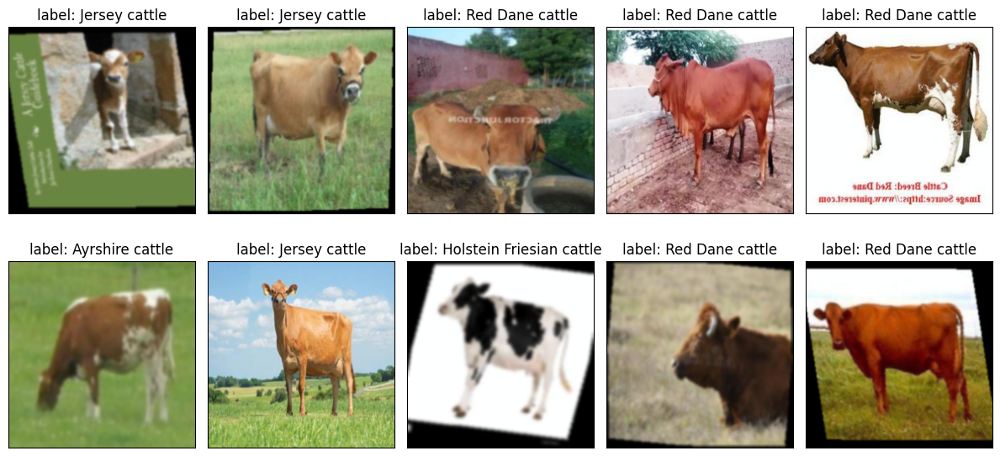

In [20]:
examples = enumerate(train_dataloader)
batch_idx, (images, labels) = next(examples)
images_=images[0:10]
labels_=labels[0:10]
plot_examples(images_, labels_, rows=2);

In [21]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [22]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter('runs/data_experiment_2')

In [23]:
# get some random training images
dataiter = iter(train_dataloader)
images, labels = next(dataiter)

img = torchvision.utils.make_grid(images)

# write to tensorboard
writer.add_image('example_images', img)

In [24]:
train_dataloader = data.DataLoader(combined_dataset, batch_size=16, shuffle=True)

In [25]:
test_dataloader = data.DataLoader(test_dataset, batch_size=16, shuffle=True)

Length of train and test split now

In [26]:
print(len(combined_dataset))
print(len(test_dataset))

1934
241


Check if cuda device available (using gpu for faster computations)

In [27]:
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using {device} device")

Using cuda device


### Simple NN model

In [28]:
class NeuralNetwork(nn.Module):
    def __init__(self):
        super().__init__()
        self.flatten = nn.Flatten()
        self.linear_relu_stack = nn.Sequential(
            nn.Linear(3*224*224, 512),
            nn.ReLU(),
            nn.Linear(512, 512),
            nn.ReLU(),
            nn.Linear(512, 5)
        )

    def forward(self, x):
        x = self.flatten(x)
        logits = self.linear_relu_stack(x)
        return logits

model = NeuralNetwork().to(device)

In [29]:
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.SGD(model.parameters(), lr=1e-3)

In [30]:
def train(dataloader, model, loss_fn, optimizer):
    size = len(dataloader.dataset)
    model.train()
    for batch, (X, y) in enumerate(dataloader):
        X, y = X.to(device), y.to(device)

        # Compute prediction error
        pred = model(X)
        loss = loss_fn(pred, y)

        # Backpropagation
        loss.backward()
        optimizer.step()
        optimizer.zero_grad()

        if batch % 100 == 0:
            loss, current = loss.item(), (batch + 1) * len(X)
            print(f"loss: {loss:>7f}  [{current:>5d}/{size:>5d}]")

In [31]:
def test(dataloader, model, loss_fn):
    size = len(dataloader.dataset)
    num_batches = len(dataloader)
    model.eval()
    test_loss, correct = 0, 0
    with torch.no_grad():
        for X, y in dataloader:
            X, y = X.to(device), y.to(device)
            pred = model(X)
            test_loss += loss_fn(pred, y).item()
            correct += (pred.argmax(1) == y).type(torch.float).sum().item()
    test_loss /= num_batches
    correct /= size
    print(f"Test Error: \n Accuracy: {(100*correct):>0.1f}%, Avg loss: {test_loss:>8f} \n")

In [32]:
epochs = 10
for t in range(epochs):
    print(f"Epoch {t+1}\n-------------------------------")
    train(train_dataloader, model, loss_fn, optimizer)
    test(test_dataloader, model, loss_fn)
print("Done!")

Epoch 1
-------------------------------
loss: 1.610464  [   16/ 1934]
loss: 1.451162  [ 1616/ 1934]
Test Error: 
 Accuracy: 42.7%, Avg loss: 1.377741 

Epoch 2
-------------------------------
loss: 1.363164  [   16/ 1934]
loss: 0.907540  [ 1616/ 1934]
Test Error: 
 Accuracy: 46.1%, Avg loss: 1.263789 

Epoch 3
-------------------------------
loss: 1.035209  [   16/ 1934]
loss: 1.338532  [ 1616/ 1934]
Test Error: 
 Accuracy: 49.4%, Avg loss: 1.261460 

Epoch 4
-------------------------------
loss: 0.885232  [   16/ 1934]
loss: 0.846552  [ 1616/ 1934]
Test Error: 
 Accuracy: 56.0%, Avg loss: 1.164180 

Epoch 5
-------------------------------
loss: 0.794173  [   16/ 1934]
loss: 0.988312  [ 1616/ 1934]
Test Error: 
 Accuracy: 55.6%, Avg loss: 1.058643 

Epoch 6
-------------------------------
loss: 0.733951  [   16/ 1934]
loss: 0.577066  [ 1616/ 1934]
Test Error: 
 Accuracy: 60.6%, Avg loss: 1.125362 

Epoch 7
-------------------------------
loss: 0.496181  [   16/ 1934]
loss: 0.528270  [ 

###Loading model

In [33]:
# Get a set of pretrained model weights
weights = torchvision.models.ResNet50_Weights.DEFAULT # .DEFAULT = best available weights from pretraining on ImageNet
weights

ResNet50_Weights.IMAGENET1K_V2

In [34]:

#  Setup the model with pretrained weights and send it to the target device
weights = torchvision.models.ResNet50_Weights.DEFAULT
model = torchvision.models.resnet50(weights=weights).to(device)

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:01<00:00, 75.2MB/s]


In [35]:
# Print a summary of model using torchinfo
summary(model=model,
        input_size=(32, 3, 224, 224),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"]
)

Layer (type (var_name))                  Input Shape          Output Shape         Param #              Trainable
ResNet (ResNet)                          [32, 3, 224, 224]    [32, 1000]           --                   True
├─Conv2d (conv1)                         [32, 3, 224, 224]    [32, 64, 112, 112]   9,408                True
├─BatchNorm2d (bn1)                      [32, 64, 112, 112]   [32, 64, 112, 112]   128                  True
├─ReLU (relu)                            [32, 64, 112, 112]   [32, 64, 112, 112]   --                   --
├─MaxPool2d (maxpool)                    [32, 64, 112, 112]   [32, 64, 56, 56]     --                   --
├─Sequential (layer1)                    [32, 64, 56, 56]     [32, 256, 56, 56]    --                   True
│    └─Bottleneck (0)                    [32, 64, 56, 56]     [32, 256, 56, 56]    --                   True
│    │    └─Conv2d (conv1)               [32, 64, 56, 56]     [32, 64, 56, 56]     4,096                True
│    │    └─BatchN

In [36]:
# Freeze weights in all layers as we do not need to train
for param in model.parameters():
    param.requires_grad = False

In [37]:
# Set the manual seeds
torch.manual_seed(42)

# Get the length of class_names
output_shape = len(class_names)

# Add a fully connected classfier layer
modelOutputFeats = model.fc.in_features
model.fc = nn.Linear(modelOutputFeats, output_shape)



Load model for device

In [38]:
model = model.to(device)

Write model to tensorboard

In [39]:
writer.add_graph(model, img.unsqueeze(0).to(device))
writer.close()

In [40]:
# Summary after freezing all layers
summary(model,
        input_size=(32, 3, 224, 224),
        verbose=0,
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"]
)

Layer (type (var_name))                  Input Shape          Output Shape         Param #              Trainable
ResNet (ResNet)                          [32, 3, 224, 224]    [32, 5]              --                   Partial
├─Conv2d (conv1)                         [32, 3, 224, 224]    [32, 64, 112, 112]   (9,408)              False
├─BatchNorm2d (bn1)                      [32, 64, 112, 112]   [32, 64, 112, 112]   (128)                False
├─ReLU (relu)                            [32, 64, 112, 112]   [32, 64, 112, 112]   --                   --
├─MaxPool2d (maxpool)                    [32, 64, 112, 112]   [32, 64, 56, 56]     --                   --
├─Sequential (layer1)                    [32, 64, 56, 56]     [32, 256, 56, 56]    --                   False
│    └─Bottleneck (0)                    [32, 64, 56, 56]     [32, 256, 56, 56]    --                   False
│    │    └─Conv2d (conv1)               [32, 64, 56, 56]     [32, 64, 56, 56]     (4,096)              False
│    │    

We need to only train the last fully connected layer which gives output

### Training model

In [41]:
# Define loss and optimizer
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

In [42]:
def matplotlib_imshow(img, one_channel=False):
    input = img.cpu().numpy().transpose((1, 2, 0))
    input = std * input + mean
    input = np.clip(input, 0, 1)     # unnormalize
    npimg = input
    plt.imshow(npimg)

In [43]:
# helper functions

def images_to_probs(net, images):
    '''
    Generates predictions and corresponding probabilities from a trained
    network and a list of images
    '''
    output = net(images)
    # convert output probabilities to predicted class
    _, preds_tensor = torch.max(output, 1)
    preds = np.squeeze(preds_tensor.cpu().numpy())
    return preds, [F.softmax(el, dim=0)[i].item() for i, el in zip(preds, output)]


def plot_classes_preds(net, images, labels):
    '''
    Generates matplotlib Figure using a trained network, along with images
    and labels from a batch, that shows the network's top prediction along
    with its probability, alongside the actual label, coloring this
    information based on whether the prediction was correct or not.
    Uses the "images_to_probs" function.
    '''
    preds, probs = images_to_probs(net, images)
    # plot the images in the batch, along with predicted and true labels
    fig = plt.figure(figsize=(50, 10))
    for idx in np.arange(10):
        ax = fig.add_subplot(1, 10, idx+1, xticks=[], yticks=[])
        matplotlib_imshow(images[idx], one_channel=True)
        ax.set_title("{0}, {1:.1f}%\n(label: {2})".format(
            class_names[preds[idx]],
            probs[idx] * 100.0,
            class_names[labels[idx]]),
                    color=("green" if preds[idx]==labels[idx].item() else "red"))
    return fig

Creating a early stopper class if change in loss less than some threshold we can stop the training process

In [44]:
class EarlyStopper:
    def __init__(self, patience=1, min_delta=0):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.min_validation_loss = np.inf

    def early_stop(self, validation_loss):
        if validation_loss < self.min_validation_loss - self.min_delta:
            self.min_validation_loss = validation_loss
            self.counter = 0
        elif validation_loss > (self.min_validation_loss - self.min_delta):
          if validation_loss < self.min_validation_loss:
            self.min_validation_loss = validation_loss
            self.counter += 1
            if self.counter >= self.patience:
                return True
        return False

Defining the training and testing methods

In [45]:
def get_correct(y_pred, y_true):
    return y_pred.argmax(dim=1).eq(y_true).sum().item()


def train(model, train_loader, optimizer, criterion):
    model.train()   # Train Mode
    dataiter = enumerate(train_loader)
    x, (img, lbl) = next(dataiter)
    img_grid = torchvision.utils.make_grid(img)  # Add sample to tensorboard

    tboard = SummaryWriter()
    tboard.add_image('images', img_grid)
    early_stopper = EarlyStopper(patience=3, min_delta=5)  # Instantiating early stopper class

    for n_epoch in range(25):   # Number of epochs
        batch_loss = 0.0
        total_loss = 0.0
        batch_correct = 0
        total_correct = 0
        for batch_idx, (X, y_true) in enumerate(train_loader):  # Iterating in batches
            X = X.to(device)
            y_true = y_true.to(device)
            y_pred = model(X)  # Get the prediction

            loss = criterion(y_pred, y_true)  # Calculate loss
            optimizer.zero_grad()  # Zero parameter gradients
            loss.backward()  # Calculate gradients
            optimizer.step()  # Update weights

            # print loss
            batch_loss += loss.item()
            total_loss += loss.item()
            batch_correct += get_correct(y_pred, y_true)
            total_correct += get_correct(y_pred, y_true)
            if batch_idx % 10 == 0:  # Every 10 batches
                writer.add_scalar("Loss/Minibatches", batch_loss/10, batch_idx)  # Logging losses in tensorboard
                batch_loss = 0.0
                batch_correct = 0
                writer.add_figure('predictions vs. actuals',
                plot_classes_preds(model, X, y_true),
                global_step=n_epoch * len(train_dataloader) + batch_idx)  # Showing prediction output 10 sample images
                tboard.add_scalar('F1_Curve', multiclass_f1_score(y_pred, y_true,  num_classes=len(class_names)).item())  # F1 score

        tboard.add_scalar('Loss', total_loss, n_epoch)  # Loggging total loss for epoch
        tboard.add_scalar('Accuracy', total_correct /
                          len(combined_dataset), n_epoch)  # Logging accuracy

        print(
          f"Epoch: {n_epoch} | "
          f"train_loss: {total_loss:.4f} | "
          f"train_acc: {total_correct /len(combined_dataset):.4f} | "
        )
        test(model, test_dataloader)
        if early_stopper.early_stop(total_loss):  # Checking early stopping
              break
        print()

    tboard.add_graph(model, img.to(device))  # sending Model in tensorboard
    tboard.close()
    print('Finished Training')
    torch.save(model.state_dict(), ('Resnet.pth'))  # Saving the model


def test(model, test_loader):
    model.eval()  # Eval Mode
    correct = 0
    total = 0
    with torch.no_grad():
        for batch_idx, (X, y_true) in enumerate(test_loader):
            X = X.to(device)
            y_true = y_true.to(device)
            y_pred = model(X)
            total += y_true.size(0)
            correct += get_correct(y_pred, y_true)
        print('Accuracy of the network on test images: %d %%' % (
            100 * correct / total))  # Pring accuracy



Training the model

In [46]:
train(model, train_dataloader, optimizer, loss_fn)


Epoch: 0 | train_loss: 137.3292 | train_acc: 0.6525 | 
Accuracy of the network on test images: 75 %

Epoch: 1 | train_loss: 81.3722 | train_acc: 0.8247 | 
Accuracy of the network on test images: 81 %

Epoch: 2 | train_loss: 62.8881 | train_acc: 0.8707 | 
Accuracy of the network on test images: 83 %

Epoch: 3 | train_loss: 52.1497 | train_acc: 0.8893 | 
Accuracy of the network on test images: 86 %

Epoch: 4 | train_loss: 44.1813 | train_acc: 0.9173 | 
Accuracy of the network on test images: 87 %

Epoch: 5 | train_loss: 39.0260 | train_acc: 0.9183 | 
Accuracy of the network on test images: 87 %

Epoch: 6 | train_loss: 36.6585 | train_acc: 0.9281 | 
Accuracy of the network on test images: 89 %

Epoch: 7 | train_loss: 31.8491 | train_acc: 0.9411 | 
Accuracy of the network on test images: 89 %

Epoch: 8 | train_loss: 28.6438 | train_acc: 0.9442 | 
Accuracy of the network on test images: 90 %
Finished Training


Testing the model to create Precision recall curve

In [47]:
# Test the network
class_probs = []
class_label = []
with torch.no_grad():
    for data in test_dataloader:
        images, labels = data
        images = images.to(device)
        labels = labels.to(device)
        output = model(images)
        class_probs_batch = [F.softmax(el, dim=0) for el in output]

        class_probs.append(class_probs_batch)
        class_label.append(labels)

test_probs = torch.cat([torch.stack(batch) for batch in class_probs])
test_label = torch.cat(class_label)

In [48]:
def add_pr_curve_tensorboard(class_index, test_probs, test_label, global_step=0):
    '''
    Takes in a "class_index" from 0 to 9 and plots the corresponding
    precision-recall curve
    '''
    tensorboard_truth = test_label == class_index
    tensorboard_probs = test_probs[:, class_index]

    writer.add_pr_curve(class_names[class_index],
                        tensorboard_truth,
                        tensorboard_probs,
                        global_step=global_step)

    writer.close()

# plot all the pr curves
for i in range(len(class_names)):
    add_pr_curve_tensorboard(i, test_probs, test_label)

### Tensorboard

In [49]:
%tensorboard --logdir=runs

<IPython.core.display.Javascript object>